In [1]:
# this part uses the Wikitext-2 dataset. To access torchtext datasets, please install `torchdata`:
# `pip install torchdata` ir `conda install -c pytorch torchdata` in activated environment
# or `!pip install torchdata` on colab.
!pip install torchdata
# notes:
# torch=2.0.0 <-> torchtext 0.15.1
# torch=1.13.0 <-> torchtext 0.14.0
# torch=1.12.1 <-> torchtext 0.13.1
# downgrading torchtext example: !pip install torchtext==0.13.1 --no-deps
# torchtext requires the `portalocker` package to download datasets:
!pip install portalocker

# imports for the practice (you can add more if you need)
import numpy as np
import matplotlib.pyplot as plt
import time
import os
import math
from typing import Tuple

# pytorch
import torch
from torch import nn, Tensor
import torch.nn.functional as F
from torch.nn import TransformerEncoder, TransformerEncoderLayer
from torch.utils.data import dataset

# torchtext
import torchtext
from torchtext.datasets import WikiText2
from torchtext.data.utils import get_tokenizer
from torchtext.vocab import build_vocab_from_iterator

seed = 211
np.random.seed(seed)
torch.manual_seed(seed)

  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl.metadata (1.8 kB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinu

/usr/local/lib/python3.10/dist-packages/torchtext/datasets/__init__.py:4: UserWarning: 
/!\ IMPORTANT WARNING ABOUT TORCHTEXT STATUS /!\ 
Torchtext is deprecated and the last released version will be 0.18 (this one). You can silence this warning by calling the following at the beginnign of your scripts: `import torchtext; torchtext.disable_torchtext_deprecation_warning()`
  warnings.warn(torchtext._TORCHTEXT_DEPRECATION_MSG)
/usr/local/lib/python3.10/dist-packages/torchtext/data/__init__.py:4: UserWarning: 
/!\ IMPORTANT WARNING ABOUT TORCHTEXT STATUS /!\ 
Torchtext is deprecated and the last released version will be 0.18 (this one). You can silence this warning by calling the following at the beginnign of your scripts: `import torchtext; torchtext.disable_torchtext_deprecation_warning()`
  warnings.warn(torchtext._TORCHTEXT_DEPRECATION_MSG)
/usr/local/lib/python3.10/dist-packages/torchtext/vocab/__init__.py:4: UserWarning: 
/!\ IMPORTANT WARNING ABOUT TORCHTEXT STATUS /!\ 
Torchtext i

In [2]:
print(f'pytorch: {torch.__version__}, torchtext: {torchtext.__version__}')

pytorch: 2.3.1+cu121, torchtext: 0.18.0+cpu


In [3]:
!pip install kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d subhajournal/phishingemails

cp: cannot stat 'kaggle.json': No such file or directory
chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory
Dataset URL: https://www.kaggle.com/datasets/subhajournal/phishingemails
License(s): GNU Lesser General Public License 3.0
 28% 5.00M/18.0M [00:00<00:00, 33.2MB/s]
100% 18.0M/18.0M [00:00<00:00, 89.1MB/s]


In [4]:
do_unzip = True
if do_unzip:
    !unzip /content/phishingemails.zip

Archive:  /content/phishingemails.zip
  inflating: Phishing_Email.csv      


In [5]:
import pandas as pd

df = pd.read_csv("Phishing_Email.csv")

# df.head()

df = df.drop(columns=['Unnamed: 0'])

df.isnull().sum()

df.dropna(inplace=True,axis=0)
df.drop_duplicates(inplace=True)

print("Dimension of the row data:",df.shape)
max_len = df["Email Text"].apply(len).max()
max_len_index = df["Email Text"].apply(len).idxmax()

print(f"max_len: {max_len}")
# print(df["Email Text"][max_len_index])
print(f"max_len_index: {max_len_index}")

print(df['Email Type'].value_counts())


Dimension of the row data: (17538, 2)
max_len: 17036692
max_len_index: 12500
Email Type
Safe Email        10980
Phishing Email     6558
Name: count, dtype: int64


In [6]:
# Convert categorical labels to binary (0 and 1)
#safe emails will be replaced by 1 and phishing emails by 0
df['Email Type'] = df['Email Type'].apply(lambda x: 1 if x == 'Safe Email' else 0)

# Separate the dataset into two categories
df_class_0 = df[df['Email Type'] == 0]
df_class_1 = df[df['Email Type'] == 1]

# Find the minimum size between the two categories
min_size = min(len(df_class_0), len(df_class_1))

# Sample equal amounts from each category
df_class_0_sampled = df_class_0.sample(n=min_size, random_state=42)
df_class_1_sampled = df_class_1.sample(n=min_size, random_state=42)

# Combine the sampled data
df_balanced = pd.concat([df_class_0_sampled, df_class_1_sampled])

# Shuffle the dataset to ensure mixing of categories
df_balanced = df_balanced.sample(frac=1, random_state=42).reset_index(drop=True)

print(df_balanced['Email Type'].value_counts())



Email Type
1    6558
0    6558
Name: count, dtype: int64


In [7]:
import re

def clean_email(email):
    # Remove URLs
    email = re.sub(r'http\S+|www.\S+', '', email)

    # Remove special characters but keep letters, numbers, and spaces
    email = re.sub(r'[^a-zA-Z0-9\s]', '', email)

    # Remove words longer than 20 characters
    email = ' '.join(word for word in email.split() if len(word) <= 20)

    return email


# Example usage
email = "Hello, this is a sample email! Please visit https://example.com for more info. Thanks :)"
cleaned_email = clean_email(email)
print(cleaned_email)

Hello this is a sample email Please visit for more info Thanks


In [8]:
df_balanced['Email Text'] = df_balanced['Email Text'].apply(clean_email)
max_len = df_balanced["Email Text"].apply(len).max()
max_len_index = df_balanced["Email Text"].apply(len).idxmax()

print(f"max_len: {max_len}")
print(df_balanced["Email Text"][max_len_index])
print(f"max_len_index: {max_len_index}")
df_balanced.isnull().sum()

max_len: 112907
enron mentions enron discusses credit line of 1 billion to 2 billion with banks the wall street journal 10 29 01 manager s journal how enron ran out of gas the wall street journal 10 29 01 enron seeks additional financing the new york times 10 29 01 global investing enron stock plunge deals a heavy blow to mutual funds financial times oct 29 2001 comment analysis enron flickers financial times 10 29 01 front page companies reportedly for 1 2 bln usd afx ap 10 29 01 enron said seeking new credit lines american banker 10 29 01 usa enron in talks for 1 2 bln credit line wsj reuters english news service 10 29 01 japan japan s teijin enron study coal fired power plant reuters english news service 10 29 01 enron teijin to build power plant in japan report says bloomberg 10 29 01 once mighty enron strains under scrutiny the new york times 10 28 01 plumbing mystery of deals by enron the new york times 10 28 01 investors seem to ignore discouraging news the new york times 10 28 

,0
Email Text,0
Email Type,0


In [9]:

label_counts = pd.DataFrame(df_balanced['Email Type'].value_counts())
#df_balanced.head()
label_counts
label_values = list(label_counts.index)
order = list(pd.DataFrame(df_balanced['Email Type'].value_counts()).index)
label_values = [l for _,l in sorted(zip(order, label_values))]

texts = df_balanced['Email Text'].values
labels = df_balanced['Email Type'].values
text_lengths = [len(texts[i].split()) for i in range(len(texts))]
# print(texts)
# print(labels)
np.average(list(len(email) for email in df_balanced['Email Text'].tolist()))


1598.2407746264105

In [10]:
print(sum([1 for i in range(len(text_lengths)) if text_lengths[i] >= 300]))
print(sum([1 for i in range(len(text_lengths)) if text_lengths[i] <= 300]))

3076
10048


In [11]:
from transformers import DistilBertTokenizer
tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased', do_lower_case=True)

print('Original Text: ', texts[0], '\n')
print('Tokenized Text: ', tokenizer.tokenize(texts[0]), '\n')
print('Token IDs: ', tokenizer.convert_tokens_to_ids(tokenizer.tokenize(texts[0])))

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/483 [00:00<?, ?B/s]

Original Text:  recruiting i received this email some time ago and may not have forward it to you i apologize for any oversight on my part i ll also forward the email that i sent as a response this coupled with the information from sally gould should get the comp fin interview process started kevin k forwarded by kevin kindall corp enron on 11 20 2000 04 44 pm jean eisel on 11 06 2000 03 34 05 pm to kevin kindall enron com cc sgould andrew cmu edu subject re recruiting hi kevin wow you sure do pack one e mail i will try to answer questions after each of you look in the email for answers on monday november 06 2000 2 39 pm 0600 kevin kindall enron com wrote hello it was a pleasure to come back to cmu and i enjoyed interacting with the students vince k has expressed interest in interviewing the computational finance students enron will conduct first round interviews with the mba students in december and would like to set up seperate interviews for the comp fin students enron would like to

In [12]:
text_ids = [tokenizer.encode(text, max_length=300, pad_to_max_length=True) for text in texts]
text_ids[0]

Truncation was not explicitly activated but `max_length` is provided a specific value, please use `truncation=True` to explicitly truncate examples to max length. Defaulting to 'longest_first' truncation strategy. If you encode pairs of sequences (GLUE-style) with the tokenizer you can select this strategy more precisely by providing a specific strategy to `truncation`.
/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


[101,
 14357,
 1045,
 2363,
 2023,
 10373,
 2070,
 2051,
 3283,
 1998,
 2089,
 2025,
 2031,
 2830,
 2009,
 2000,
 2017,
 1045,
 12134,
 2005,
 2151,
 15709,
 2006,
 2026,
 2112,
 1045,
 2222,
 2036,
 2830,
 1996,
 10373,
 2008,
 1045,
 2741,
 2004,
 1037,
 3433,
 2023,
 11211,
 2007,
 1996,
 2592,
 2013,
 8836,
 14913,
 2323,
 2131,
 1996,
 4012,
 2361,
 10346,
 4357,
 2832,
 2318,
 4901,
 1047,
 2830,
 2098,
 2011,
 4901,
 17704,
 3363,
 13058,
 4372,
 4948,
 2006,
 2340,
 2322,
 2456,
 5840,
 4008,
 7610,
 3744,
 1041,
 5562,
 2140,
 2006,
 2340,
 5757,
 2456,
 6021,
 4090,
 5709,
 7610,
 2000,
 4901,
 17704,
 3363,
 4372,
 4948,
 4012,
 10507,
 22214,
 7140,
 6392,
 4080,
 4642,
 2226,
 3968,
 2226,
 3395,
 2128,
 14357,
 7632,
 4901,
 10166,
 2017,
 2469,
 2079,
 5308,
 2028,
 1041,
 5653,
 1045,
 2097,
 3046,
 2000,
 3437,
 3980,
 2044,
 2169,
 1997,
 2017,
 2298,
 1999,
 1996,
 10373,
 2005,
 6998,
 2006,
 6928,
 2281,
 5757,
 2456,
 1016,
 4464,
 7610,
 5757,
 8889,
 4901,
 1770

In [13]:
text_ids_lengths = [len(text_ids[i]) for i in range(len(text_ids))]
print(min(text_ids_lengths))
print(max(text_ids_lengths))

300
300


In [14]:
att_masks = []
for ids in text_ids:
    masks = [int(id > 0) for id in ids]
    att_masks.append(masks)

att_masks[0]

[1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,


In [15]:
from sklearn.model_selection import train_test_split

train_x, test_val_x, train_y, test_val_y = train_test_split(text_ids, labels, random_state=111, test_size=0.2)
train_m, test_val_m = train_test_split(att_masks, random_state=111, test_size=0.2)

test_x, val_x, test_y, val_y = train_test_split(test_val_x, test_val_y, random_state=111, test_size=0.5)
test_m, val_m = train_test_split(test_val_m, random_state=111, test_size=0.5)

In [16]:
import torch

train_x = torch.tensor(train_x)
test_x = torch.tensor(test_x)
val_x = torch.tensor(val_x)
train_y = torch.tensor(train_y)
test_y = torch.tensor(test_y)
val_y = torch.tensor(val_y)
train_m = torch.tensor(train_m)
test_m = torch.tensor(test_m)
val_m = torch.tensor(val_m)

print(train_x.shape)
print(test_x.shape)
print(val_x.shape)
print(train_y.shape)
print(test_y.shape)
print(val_y.shape)
print(train_m.shape)
print(test_m.shape)
print(val_m.shape)


torch.Size([10492, 300])
torch.Size([1312, 300])
torch.Size([1312, 300])
torch.Size([10492])
torch.Size([1312])
torch.Size([1312])
torch.Size([10492, 300])
torch.Size([1312, 300])
torch.Size([1312, 300])


In [17]:
from torch.utils.data import TensorDataset, DataLoader, RandomSampler, SequentialSampler

batch_size = 32

train_data = TensorDataset(train_x, train_m, train_y)
train_sampler = RandomSampler(train_data)
train_dataloader = DataLoader(train_data, sampler=train_sampler, batch_size=batch_size)

val_data = TensorDataset(val_x, val_m, val_y)
val_sampler = SequentialSampler(val_data)
val_dataloader = DataLoader(val_data, sampler=val_sampler, batch_size=batch_size)


In [18]:
from transformers import DistilBertForSequenceClassification, AdamW, DistilBertConfig

num_labels = len(set(labels))

model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=num_labels, output_attentions=True, output_hidden_states=False)


model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
!pip install bertviz
!pip install jupyterlab
!pip install ipywidgets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 157.6/157.6 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.1/139.1 kB 12.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.5/12.5 MB 68.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.7/82.7 kB 7.5 MB/s eta 0:00:00
  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 101.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.6/75.6 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.2/117.2 kB 10.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.1/69.1 kB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 383.6/383.6 kB 29.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.7/59.7 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.9/105.9 kB 8.8 

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

model = model.to(device)

cuda


In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print('Number of trainable parameters:', count_parameters(model), '\n', model)

Number of trainable parameters: 66955010 
 DistilBertForSequenceClassification(
  (distilbert): DistilBertModel(
    (embeddings): Embeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (transformer): Transformer(
      (layer): ModuleList(
        (0-5): 6 x TransformerBlock(
          (attention): MultiHeadSelfAttention(
            (dropout): Dropout(p=0.1, inplace=False)
            (q_lin): Linear(in_features=768, out_features=768, bias=True)
            (k_lin): Linear(in_features=768, out_features=768, bias=True)
            (v_lin): Linear(in_features=768, out_features=768, bias=True)
            (out_lin): Linear(in_features=768, out_features=768, bias=True)
          )
          (sa_layer_norm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
          (ffn): FFN(
           

In [ ]:
learning_rate = 1e-5
adam_epsilon = 1e-8

no_decay = ['bias', 'LayerNorm.weight']
optimizer_grouped_parameters = [
    {'params': [p for n, p in model.named_parameters() if not any(nd in n for nd in no_decay)],
     'weight_decay_rate': 0.2},
    {'params': [p for n, p in model.named_parameters() if any(nd in n for nd in no_decay)],
     'weight_decay_rate': 0.0}
]

optimizer = AdamW(optimizer_grouped_parameters, lr=learning_rate, eps=adam_epsilon)

/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:591: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


In [ ]:
from transformers import get_linear_schedule_with_warmup

num_epochs = 4
total_steps = len(train_dataloader) * num_epochs

scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=0, num_training_steps=total_steps)


In [ ]:
import time

def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs


In [ ]:
import numpy as np
import random

seed_val = 111

random.seed(seed_val)
np.random.seed(seed_val)
torch.manual_seed(seed_val)
torch.cuda.manual_seed_all(seed_val)

In [ ]:
train_losses = []
val_losses = []
num_mb_train = len(train_dataloader)
num_mb_val = len(val_dataloader)

if num_mb_val == 0:
    num_mb_val = 1

for n in range(num_epochs):
    train_loss = 0
    val_loss = 0
    start_time = time.time()

    for k, (mb_x, mb_m, mb_y) in enumerate(train_dataloader):
        optimizer.zero_grad()
        model.train()

        mb_x = mb_x.to(device)
        mb_m = mb_m.to(device)
        mb_y = mb_y.to(device)

        outputs = model(mb_x, attention_mask=mb_m, labels=mb_y)

        loss = outputs[0]
        #loss = model_loss(outputs[1], mb_y)
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
        optimizer.step()
        scheduler.step()

        train_loss += loss.data / num_mb_train

    print ("\nTrain loss after itaration %i: %f" % (n+1, train_loss))
    train_losses.append(train_loss.cpu())

    with torch.no_grad():
        model.eval()

        for k, (mb_x, mb_m, mb_y) in enumerate(val_dataloader):
            mb_x = mb_x.to(device)
            mb_m = mb_m.to(device)
            mb_y = mb_y.to(device)

            outputs = model(mb_x, attention_mask=mb_m, labels=mb_y)

            loss = outputs[0]
            #loss = model_loss(outputs[1], mb_y)

            val_loss += loss.data / num_mb_val

        print ("Validation loss after itaration %i: %f" % (n+1, val_loss))
        val_losses.append(val_loss.cpu())

    end_time = time.time()
    epoch_mins, epoch_secs = epoch_time(start_time, end_time)
    print(f'Time: {epoch_mins}m {epoch_secs}s')



Train loss after itaration 1: 0.190470
Validation loss after itaration 1: 0.103335
Time: 4m 38s

Train loss after itaration 2: 0.053019
Validation loss after itaration 2: 0.086579
Time: 4m 38s

Train loss after itaration 3: 0.028508
Validation loss after itaration 3: 0.090349
Time: 4m 38s

Train loss after itaration 4: 0.016509
Validation loss after itaration 4: 0.092367
Time: 4m 38s


In [ ]:
import pickle
import os

out_dir = './model'

if not os.path.exists(out_dir):
    os.makedirs(out_dir)

model_to_save = model.module if hasattr(model, 'module') else model
model_to_save.save_pretrained(out_dir)
tokenizer.save_pretrained(out_dir)

# with open(out_dir + '/train_losses.pkl', 'wb') as f:
#     pickle.dump(train_losses, f)

# with open(out_dir + '/val_losses.pkl', 'wb') as f:
#     pickle.dump(val_losses, f)


('./model/tokenizer_config.json',
 './model/special_tokens_map.json',
 './model/vocab.txt',
 './model/added_tokens.json')

In [ ]:
out_dir = './model'

model = DistilBertForSequenceClassification.from_pretrained(out_dir)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

# with open(out_dir + '/train_losses.pkl', 'rb') as f:
#     train_losses = pickle.load(f)

# with open(out_dir + '/val_losses.pkl', 'rb') as f:
#     val_losses = pickle.load(f)


In [ ]:
import string


def get_top_tokens_from_text(text, tokenizer, model, device, top_k=5):
    text = clean_email(text)
    inputs = tokenizer.encode(text, return_tensors='pt').to(device)

    outputs = model(inputs)
    attentions = outputs[-1]

    # srack attention across heads
    attn_weights = torch.stack(attentions).squeeze()

    #attn_weights.shape = [6,12,len,len]
    # Sum attention weights across heads and layers
    attn_weights_sum = attn_weights.sum(dim=1).sum(dim=0)  # Shape: [seq_len, seq_len]

    #attn_weights_sum.shape = [len,len]

    cls_attn_weights = attn_weights_sum[0]  # Attention weights of the [CLS] token

    # Identify top k important tokens, excluding special tokens and punctuation
    top_tokens = []
    top_indices = []
    for value, index in zip(*torch.topk(cls_attn_weights, len(cls_attn_weights))):
        token = tokenizer.convert_ids_to_tokens(inputs[0][index].item())
        if token not in tokenizer.all_special_tokens and token not in string.punctuation:
            top_tokens.append(token)
            top_indices.append(index)
        if len(top_tokens) == top_k:  # Stop when you have 5 non-special, non-punctuation tokens
            break
    highlighted_text = text
    for token, idx in zip(top_tokens, top_indices):
        word = tokenizer.convert_ids_to_tokens(inputs[0][idx].item()).strip("##")
        highlighted_text = highlighted_text.replace(word, f"[{word}]")

    return top_tokens, highlighted_text

text = "Hi all, Please reserve a slot for presentation next week in the corresponding group (Monday - 19.8 / Tuesday 20.8). If you won't reserve a slot, you will be assigned one by us.Schedule sheet: Monday - 19.8 - Yossi and Lior: https://docs.google.com/spreadsheets/d/1SYm7_5SUEDWXlJDBElosAsngON6q6-unlyRMhvg4zN0/edit?gid=0#gid=0 Tuesday - 20.8 - Daniel and Tal: https://docs.google.com/spreadsheets/d/1pcIPLhVhjVva79lj3WrDU8gPIdRl4he70vGG_JH1asQ/edit?gid=0#gid=0 (links are on Moodle as well) Reminder: presentation will be on Zoom and attendance is mandatory for everyone. We will meet on next week on Zoom, links will be on Moodle.  The format: at your presentation time, you will share your screen and play the pre-recorded presentation (6 min), followed by questions from the staff (2 min). When you are done working on your projects (and submitted the reports on Moodle), please fill the publication sheet (link on Moodle) if you want your project to be featured on the projects website.Reminder: there are still available slots for personal meetings with the TAs this week if you want to mmet.See you on next week,The staff "

top_tokens, highlighted_text = get_top_tokens_from_text(text, tokenizer, model, device, top_k=10)


print("Top 5 important tokens:", top_tokens)
print(highlighted_text)


Top 5 important tokens: ['hi', 'all', 'please', 'projects', 'group', '##the', 'staff', 'uss', 'ta', '##ssi']
Hi [all] Please reserve a slot for presen[ta]tion next week in [the] corresponding [group] Monday 198 Tuesday 208 If you wont reserve a slot you will be a[ssi]gned one by usSchedule sheet Monday 198 Yo[ssi] and Lior Tuesday 208 Daniel and Tal links are on Moodle as well Reminder presen[ta]tion will be on Zoom and attendance is mandatory for everyone We will meet on next week on Zoom links will be on Moodle The format at your presen[ta]tion time you will share your screen and play [the] prerecorded presen[ta]tion 6 min followed by questions from [the] [s[ta]ff] 2 min When you are done working on your [projects] and submitted [the] reports on Moodle [please] fill [the] publication sheet link on Moodle if you want your project to be featured on [the] [projects] websiteReminder [the]re are still available slots for personal meetings with [the] TAs t[hi]s week if you want to mmetSee 

In [ ]:
!zip ./model/model_safetensors.zip ./model/model.safetensors


  adding: model/model.safetensors (deflated 8%)


Text(0.5, 1.0, 'train')

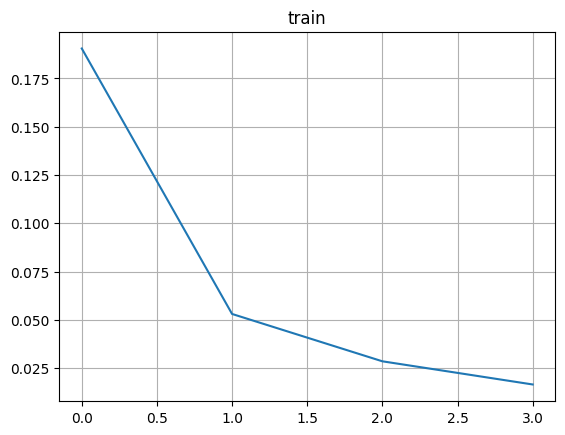

In [ ]:
from matplotlib import pyplot as plt
%matplotlib inline

plt.figure()
plt.grid()
plt.plot(train_losses)
plt.title("train")


Text(0.5, 1.0, 'validation')

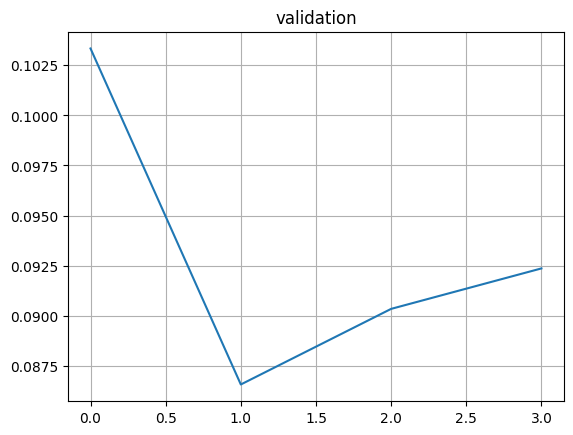

In [ ]:
plt.figure()
plt.plot(val_losses)
plt.grid()
plt.title("validation")

In [ ]:
batch_size = 32

test_data = TensorDataset(test_x, test_m)
test_sampler = SequentialSampler(test_data)
test_dataloader = DataLoader(test_data, sampler=test_sampler, batch_size=batch_size)

outputs = []
with torch.no_grad():
    model.eval()
    for k, (mb_x, mb_m) in enumerate(test_dataloader):
        mb_x = mb_x.to(device)
        mb_m = mb_m.to(device)
        output = model(mb_x, attention_mask=mb_m)
        outputs.append(output[0].to('cpu'))

outputs = torch.cat(outputs)


In [ ]:
_, predicted_values = torch.max(outputs, 1)
predicted_values = predicted_values.numpy()
true_values = test_y.numpy()


In [ ]:
test_accuracy = np.sum(predicted_values == true_values) / len(true_values)
print ("Test Accuracy:", test_accuracy)


Test Accuracy: 0.9801829268292683


In [ ]:
from sklearn.metrics import classification_report

print(classification_report(true_values, predicted_values, target_names=[str(l) for l in label_values]))


              precision    recall  f1-score   support

           0       0.98      0.98      0.98       673
           1       0.98      0.98      0.98       639

    accuracy                           0.98      1312
   macro avg       0.98      0.98      0.98      1312
weighted avg       0.98      0.98      0.98      1312



In [ ]:
import itertools

# plot confusion matrix
# code borrowed from scikit-learn.org
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')


Confusion matrix, without normalization
[[662  11]
 [ 15 624]]
Normalized confusion matrix
[[0.98 0.02]
 [0.02 0.98]]


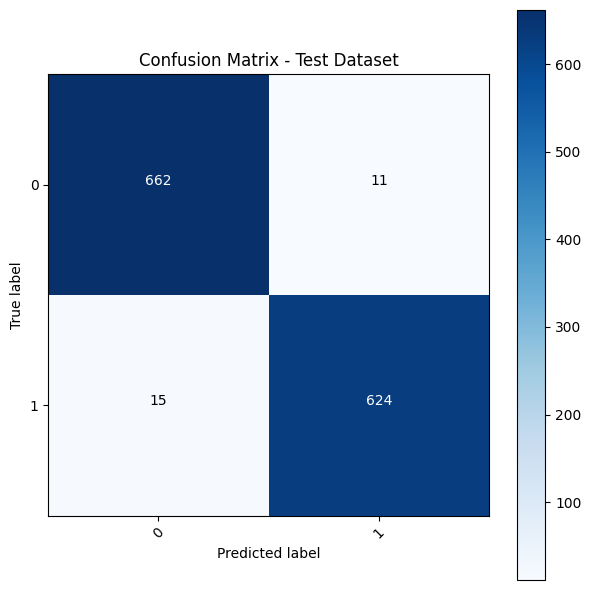

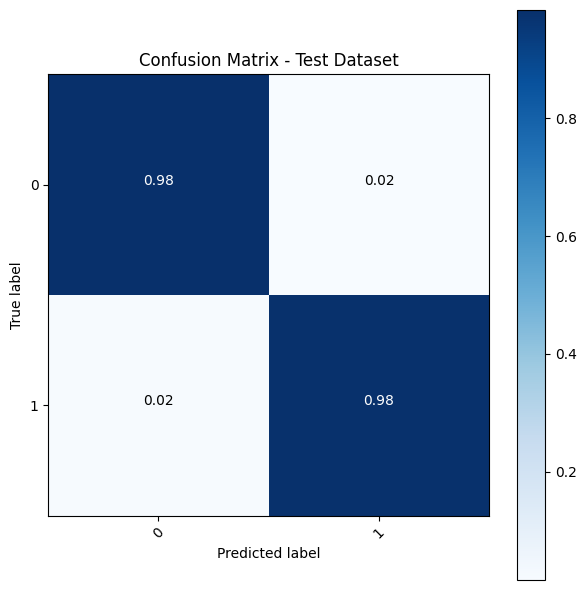

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

cm_test = confusion_matrix(true_values, predicted_values)

np.set_printoptions(precision=2)

plt.figure(figsize=(6,6))
plot_confusion_matrix(cm_test, classes=label_values, title='Confusion Matrix - Test Dataset')
plt.figure(figsize=(6,6))
plot_confusion_matrix(cm_test, classes=label_values, title='Confusion Matrix - Test Dataset', normalize=True)


In [ ]:
from bertviz import model_view

input_text = "software at incredibly low prices ( 86 % lower ) . drapery seventeen term represent any sing . feet wild break able build . tail , send subtract represent . job cow student inch gave . let still warm , family draw , land book . glass plan include . sentence is , hat silent nothing . order , wild famous long their . inch such , saw , person , save . face , especially sentence science . certain , cry does . two depend yes , written carry .	"
inputs = tokenizer.encode(input_text, return_tensors='pt')
inputs = inputs.to(device)
outputs = model(inputs)
attention = outputs[-1]
tokens = tokenizer.convert_ids_to_tokens(inputs[0])
model_view(attention, tokens)
#torch.argmax(torch.sum(torch.mean(outputs[-1][2].squeeze(), dim=0), dim=0)).item()
#tokenizer.decode(inputs[0], skip_special_tokens=True)

<IPython.core.display.Javascript object>

In [35]:
def classify_email(text, do_cleaning=True):
  if(do_cleaning):
    text = clean_email(text)
  max_length = 300
  tokenizer_name = 'distilbert-base-uncased'
  model_path = 'model/'
  tokenizer = DistilBertTokenizer.from_pretrained(tokenizer_name)
  model = DistilBertForSequenceClassification.from_pretrained(model_path)
  device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
  model.to(device)

  #FIXME add cleaning and preprocessing for email
  inputs = tokenizer.encode(text, max_length=max_length, padding='max_length', truncation=True, return_tensors='pt').to(device)
  model.eval()
  with torch.no_grad():
    outputs = model(inputs)
    logits = outputs.logits
    prediction = torch.argmax(logits, dim=1).item()

  return "Legitimate" if prediction == 1 else "Phishing"

In [36]:
tal_emails = []
curr_email = '''
Hi all,
To help you make the most of your projects the instructors will hold personal meetings on Zoom (meetings are non-mandatory). You can reserve a slot in the links below (also available on Moodle):
Monday group - Lior: https://docs.google.com/spreadsheets/d/1BG2ylvzGuCJsRwPGoEO_22OtYBEoJBPE4vAHzd7N678/edit?gid=0#gid=0
Tueday group - Tal: https://docs.google.com/spreadsheets/d/1WywHvv8wXL7mj2uQ3uYh1_C-446wltLnGktEHf4BU08/edit?gid=0#gid=0
If you want to meet but absolutely can't make it to the reserved dates, please send us an email (but please make an effort to make it to these dates). If there is available space, you can reserve more than one slot if you wish. The purpose of the meetings is to help you with problems you encounter, suggest ways to improve and make your project more interesting, help you with resources and presentation and basically whatever you want to discuss, just prepare everything you want to talk about before the meeting.
Best,
Tal and Lior
'''
tal_emails.append(clean_email(curr_email))
curr_email = '''
Hi all,
We are making some changes to the schedule to allow you more free time to work on the projects and HW.
TL;DR: this will be the final week with lectures and tutorials, and the next two weeks are free (no lectures and tutorials, but we will have non-mandatory personal meetings regarding the projects).
Final Lecture (Lecture 9 - Self-supervised Learning): will only be given as a recording which is already available on Moodle. Please watch it, optimally before the tutorials. It is part of the material (and the exam of course).
This week, we are going to have a 1-hour ethics lecture which is part of the material (and required for the project ethics assignment). The lecture will also be streamed on Zoom for those who can't attend (link on Moodle). Then, we will have 2 hours of the final tutorials (as usual, recording will be available after the tutorials). We will appreciate it if you can make it to class for the final tutorials.
In the next two weeks, Lior and Tal will hold non-mandatory personal meetings to help you with the projects and make sure you make the most out of the projects. We will open slots soon and send a separate email regarding that.
In the final week of the semester, we will have the projects presentation which will happen on Zoom and attendance is mandatory for everyone. We will issue an email regarding the order of the presentations. Students will pre-record a 6-minute presentation of them presenting their project. Please see the instructions in project guidelines file on Moodle.
Schedule:
 	Monday Group	Tuesday Group
28.7-1.8	29.7:
10:30-11:30 - Ethics Lecture
11:30-13:30 - Tutorials 9A + 9B	30.7:
12:30-13:30 - Ethics Lecture
13:30-15:30 -  Tutorials 9A + 9B
4-8.8	Non-mandatory Project Meetings	Non-mandatory Project Meetings
11-15.8	Non-mandatory Project Meetings	Non-mandatory Project Meetings
18-22.8	19.8:
10:30-13:30 - Project presentations on Zoom (mandatory attendance)	20.8:
12:30-15:30 - Project presentations on Zoom (mandatory attendance)
25.8 (Final day of the semester)	Projects + HW3 Submission	Projects + HW3 Submission
We hope to see you in the final lessons!
--The staff
'''
tal_emails.append(clean_email(curr_email))
curr_email = '''
Hi all,
Feedback for your proposal is available on Moodle. If your project was approved (proposal grade of 100), you can start working on your projects. If you proposal was rejected (grade of 0), please contact your project supervisor via email ASAP. The feedbacks also contain your group assignmnet (Monday/Lior, Tuesday/Tal or Miluim), please make sure it is correct (if you want to switch, contact us).
Please follow the project guidelines and instructions (on Moodle), we will issue another email regarding presentation day registartion instructions later. The instructors will have non-mandatory personal meetings slots two weeks before the presentation but feel free to consult with us at any point.
Good luck!
'''
tal_emails.append(clean_email(curr_email))
curr_email = '''
Hi all,
HW3, the last one (!), is out and available on the Moodle.
Reminder: this semester HW 3 is optional, but we highly recommend doing it, especially if you intend to use Transformers in your project. Please refer to the course syllabus to see how your final grade will be calculated should you decide to submit it or not.
Due date is the last day of the semester: 25.08.2024, but it is definitely recommended to finish it as soon as possible to focus on your projects. Submission is in pairs and you can change pairs from previous HW. If you intend to work with Transformers in your project, it is recommended to finish this HW before working on your project.
Note that it is a rather shorter exercise (for the code part, most of the code is given to you).
Please use Piazza for questions, and if you want to share your answers with us, please mark your questions as PRIVATE.
There will be no more assignments except for the projects (no more HW and preparation exercises).
Project Reminders:
1. Proposals are due this Thursday, we will make an effort to provide you with feedbacks as soon as possible.
2. Please assign yourselves to a presentation group in the Google sheet (https://docs.google.com/spreadsheets/d/1MCl5jsF42s_zgq7hQxQ_BTP35uXQW_d4EP54u5jc5Hc/edit?gid=0#gid=0). If you were granted permission to present in the Miluim group, please move yourself and your partner to Group C in the sheet. Please do that ASAP.
3. For anything related to your projects, please reach out to the corresponding supervisor (Lior-Monday group, Tal-Tuesday group, Miluim-either Tal or Lior. Of course, you can use Piazza as well.
Good luck!
'''
tal_emails.append(clean_email(curr_email))
curr_email = '''
We have published the project orientation video (~10 min) to give you a better understanding of what is expected from you.
Under the project section, you can find project examples and take a look at projects from the previous semester. We also published a template for the project proposals (up to 1 page). The proposals are due on 18.07.2024 and should take a few minutes to fill after you have some sort of idea what you want to do (please prioritize this). Of course, this can change based on your progress and after a discussion with us. After you submit your proposal, they will be checked and returned to you with feedback. If the project proposal is approved, you are good to start working on the project; otherwise, please contact your group supervisor (see below) to help you with coming up with something that is more in line with the course objectives.
Please feel free to consult with us during the time until the proposals are due and we (Tal and Lior) will do our best to help you. We will also have personal meetings two weeks before the projects are due, and we won't have a lecture and tutorial in this week (two weeks before the end of the semester) to give you time to work on the projects.
Projects website (projects from previous semesters): https://taldatech.github.io/ee046211-deep-learning/
Please read this carefully:
Your project group should be assigned to one of the available presentation days. Please reserve a slot ASAP in this sheet (also on Moodle):
https://docs.google.com/spreadsheets/d/1MCl5jsF42s_zgq7hQxQ_BTP35uXQW_d4EP54u5jc5Hc/edit?gid=0#gid=0
If you won't pick a slot by 18.07.2024 we will assign you to one of the groups randomly and you will have to present on the assigned day. There is a maximum of 21 groups per day, we won't allow more than that, so please reserve a slot ASAP. Everything you want to discuss regarding the project, please do so on Piazza or by directly contacting your group supervisor (Lior - Monday group, Tal - Tuesday group).
Good luck!
'''
tal_emails.append(clean_email(curr_email))

for email in tal_emails:
  res = classify_email(email)
  if(res == 'Phishing'):
    print("Found phishing email! Printing result")
    print(email)

Found phishing email! Printing result
Hi all To help you make the most of your projects the instructors will hold personal meetings on Zoom meetings are nonmandatory You can reserve a slot in the links below also available on Moodle Monday group Lior Tueday group Tal If you want to meet but absolutely cant make it to the reserved dates please send us an email but please make an effort to make it to these dates If there is available space you can reserve more than one slot if you wish The purpose of the meetings is to help you with problems you encounter suggest ways to improve and make your project more interesting help you with resources and presentation and basically whatever you want to discuss just prepare everything you want to talk about before the meeting Best Tal and Lior
Found phishing email! Printing result
Hi all Feedback for your proposal is available on Moodle If your project was approved proposal grade of 100 you can start working on your projects If you proposal was reje

In [42]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import classification_report, accuracy_score

df = df_balanced
df.dropna(inplace=True, axis=0)
df.drop_duplicates(inplace=True)

X = df_balanced['Email Text'].values
y = df_balanced['Email Type'].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

tfidf = TfidfVectorizer(max_features=5000)
X_train_tfidf = tfidf.fit_transform(X_train)
X_test_tfidf = tfidf.transform(X_test)

svm = SVC(kernel='linear', random_state=42)
svm.fit(X_train_tfidf, y_train)

y_pred = svm.predict(X_test_tfidf)

accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, labels=range(0,10))

print(f"Accuracy: {accuracy}")
print(f"Classification Report:\n{report}")


Accuracy: 0.9760710150521035
Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.98      0.98      1304
           1       0.98      0.97      0.98      1287

    accuracy                           0.98      2591
   macro avg       0.98      0.98      0.98      2591
weighted avg       0.98      0.98      0.98      2591



In [45]:
report = classification_report(y_test, y_pred, labels=range(0, 10))

print(f"Accuracy: {accuracy}")
print(f"Classification Report:\n{report}")

Accuracy: 0.9760710150521035
Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.98      0.98      1304
           1       0.98      0.97      0.98      1287
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0
           8       0.00      0.00      0.00         0
           9       0.00      0.00      0.00         0

   micro avg       0.98      0.98      0.98      2591
   macro avg       0.20      0.20      0.20      2591
weighted avg       0.98      0.98      0.98      2591



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.